
#  <img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">   “ Job-related Training Recommendation system”


___

DEMO : [Job-related Training Recommendation system](https://trainjobapp.pythonanywhere.com/)

## problem statement
- Continuous training is crucial for creating and maintaining the right skill-profile for the employees. I aimed to formalize the problem of training recommendation to the employee,  taking into account the employee’s training and work history.


## Summry 

#### About The Idea 
- There is a tremendous variety in the available trainings within an organization: technical, project management, quality, leadership, domain-specific, soft-skills, etc. Hence it is important to assist the employee in choosing the best trainings, which perfectly suits his/her background, project needs and career goals. For this project, I focus on creatin a training recommendation in an industrial setting.

#### About The Data 
- contains the percent frequency data associated with Education, Training, Skills  and Experience Content Model elements. It is displayed in 15 tab delimited fields and identified using the column names provided above. Item rating level metadata is provided in columns named N, Standard Error, Lower CI Bound, Upper CI Bound, Recommend Suppress, Date, and Domain Source. The 15 fields are represented by one row. There are a total of 107,626  rows of data in this file.
- Important Featurs : 
   -  Categories associated with the Education, Training, and Experience content area. Categories for the following scales are included: Required Level of Education (RL), Related Work Experience (RW), On-Site or In-Plant Training (PT), and On-The-Job Training (OJ).
   -  The on-the-job training method takes place in a normal working situation, using the actual tools, equipment, documents or materials that trainees will use when fully trained.
   -  On-Site Or In-Plant Training  method also involves employee training at a site away from the actual work environment. It often utilizes lectures, seminars, case studies.
  
#### About The Model 
- Recommendation systems predict the future preferences of users based on their previous interactions with the items or it  Identifies a set of N items that will be of interest to a certain  user ( top-N recommendation problem).  I used the Word2Vec techniques implemented in the gensim. The model is trained using the input data and the dictionary. The output of the technique is continuous vector representation of words, which can be used as features by different applications. Word2vec (W2V) methods come from the Natural Language Processing (NLP) community. They were designed to produce low-dimensional distributional word representations. Theywere successfully applied to recommendation to generate user and product embeddings as they can scale to millions of items.



#### Data Dictionary 
| Column name          	| Dataset                     	| Description                                                                                                             	|
|----------------------	|-----------------------------	|-------------------------------------------------------------------------------------------------------------------------	|
| job_id               	| training_experience_dataset 	| O*NET-SOC Code                                                                                                          	|
| title                	| training_experience_dataset 	| displayed O*NET-SOC job titles                                                                                          	|
| element_id           	| training_experience_dataset 	| Content Model Outline Position                                                                                          	|
| element_name         	| training_experience_dataset 	| Content Model Element Name - Education, Work Experience, On-Site or In-Plant Training , On-The-Job Training, and skills 	|
| scale_id             	| training_experience_dataset 	| Scale ID                                                                                                                	|
| scale_name           	| training_experience_dataset 	| Scale Name , Content Categories along with scale name example : Required Level Of Education (Categories 1-12)           	|
| category             	| training_experience_dataset 	| Percent frequency category- Category value associated with element                                                      	|
| data_value           	| training_experience_dataset 	| Rating associated with the O*NET-SOC occupation                                                                         	|
| N                    	| training_experience_dataset 	| Sample size                                                                                                             	|
| date                 	| training_experience_dataset 	| Date when data was updated                                                                                              	|
| domain_source        	| training_experience_dataset 	| Source of the data                                                                                                      	|
| normalized           	| training_experience_dataset 	| data_value normalized                                                                                                   	|
| category_description 	| categories                  	| Detail description of category associated with element                                                                  	|



<br>


# Content :

##  Collecting Data

   - Data Source
     - <p style="text-align: left" >Data includes information from <a href="https://services.onetcenter.org/">O*NET Web Services</a> by the U.S. Department of Labor, Employment and Training Administration (USDOL/ETA). Used under the <a href="https://creativecommons.org/licenses/by/4.0/">CC BY 4.0</a> license. O*NET&reg; is a trademark of USDOL/ETA.</p>
   - combine multiple Data

##  Data Cleaning 
   - Fix columns names
   - Rename Columns
   - Drop Unused Columns
   - Data slicing
   - Data mapping
   - Save Dataset


##  EDA 
- Explore the most common job titles
- Explore the most required skills
- Visulize The Top 30 Skills 
- Formal Education And Experience Requirement
- Job Titles And Training Scale
- Mean Value Of The Formal Education And Experience Requirement in all categories
- Distribution of Job Requirments Scale
- Distribution of Job skills

## Model 

- The implemented demo [Created Online Demo](https://trainjobapp.pythonanywhere.com/)

## Conclusion 

## Future Work 
___

In [2]:
import numpy as np
import pandas as pd
from scipy.stats import norm
from scipy  import stats
import glob
from tqdm import tqdm
from gensim.models import Word2Vec 
import random
import umap
from sklearn.decomposition import IncrementalPCA    # inital reduction
from sklearn.manifold import TSNE  # final reduction
import ipywidgets as widgets

import sys
from tabulate import tabulate

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

In [3]:


import seaborn as sns
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
import plotly.offline as py
import plotly.express as px

init_notebook_mode(connected=True)

plt.style.use('seaborn-ticks')
# print(plt.style.available)




##  Collecting Data

   - Data Source
   - combine multiple Data

In [4]:


path = '/Users/sara/Desktop/capstone/capstone_in' # use your path
all_files = glob.glob(path + "/*.xlsx")
all_files
li = []
for filename in all_files:
    df = pd.read_excel(filename, index_col=None, header=0)
    li.append(df)

In [5]:
all_files

['/Users/sara/Desktop/capstone/capstone_in/Abilities.xlsx',
 '/Users/sara/Desktop/capstone/capstone_in/Skills.xlsx',
 '/Users/sara/Desktop/capstone/capstone_in/Scales Reference.xlsx',
 '/Users/sara/Desktop/capstone/capstone_in/Education, Training, and Experience Categories.xlsx',
 '/Users/sara/Desktop/capstone/capstone_in/Content Model Reference.xlsx',
 '/Users/sara/Desktop/capstone/capstone_in/Education, Training, and Experience.xlsx']

In [6]:
#  Training,Education, skills, and Experience
train_exp = pd.concat([li[1],li[5]], sort = True)
train_exp.head()

,Category,Data Value,Date,Domain Source,Element ID,Element Name,Lower CI Bound,N,Not Relevant,O*NET-SOC Code,Recommend Suppress,Scale ID,Scale Name,Standard Error,Title,Upper CI Bound
0,NaN,4.12,07/2014,Analyst,2.A.1.a,Reading Comprehension,3.88,8.0,NaN,11-1011.00,N,IM,Importance,0.13,Chief Executives,4.37
1,NaN,4.75,07/2014,Analyst,2.A.1.a,Reading Comprehension,4.43,8.0,N,11-1011.00,N,LV,Level,0.16,Chief Executives,5.07
2,NaN,4.12,07/2014,Analyst,2.A.1.b,Active Listening,3.88,8.0,NaN,11-1011.00,N,IM,Importance,0.13,Chief Executives,4.37
3,NaN,4.88,07/2014,Analyst,2.A.1.b,Active Listening,4.43,8.0,N,11-1011.00,N,LV,Level,0.23,Chief Executives,5.32
4,NaN,4.00,07/2014,Analyst,2.A.1.c,Writing,4.00,8.0,NaN,11-1011.00,N,IM,Importance,0.00,Chief Executives,4.00


##  Data Cleaning 
   - Fix columns names
   - Rename Columns
   - Drop Unused Columns
   - Data slicing
   - Data mapping
   - Save Dataset

In [7]:
# Fix column Names
train_exp.columns = train_exp.columns.str.lower()
train_exp.columns = train_exp.columns.str.replace(' ', '_',)


In [8]:
# Rename column
train_exp.rename(columns={'o*net-soc_code':'job_id'} ,inplace= True)

In [9]:
# Drop Colunms
train_exp.drop(['lower_ci_bound', 'n', 'not_relevant','upper_ci_bound','recommend_suppress','standard_error'], axis= 1, inplace=True)

In [10]:
# Create new Column
train_exp['normalized'] = (train_exp['data_value'] - train_exp['data_value'].min()) / (train_exp['data_value'].max() - train_exp['data_value'].min())
train_exp.head()

,category,data_value,date,domain_source,element_id,element_name,job_id,scale_id,scale_name,title,normalized
0,NaN,4.12,07/2014,Analyst,2.A.1.a,Reading Comprehension,11-1011.00,IM,Importance,Chief Executives,0.0412
1,NaN,4.75,07/2014,Analyst,2.A.1.a,Reading Comprehension,11-1011.00,LV,Level,Chief Executives,0.0475
2,NaN,4.12,07/2014,Analyst,2.A.1.b,Active Listening,11-1011.00,IM,Importance,Chief Executives,0.0412
3,NaN,4.88,07/2014,Analyst,2.A.1.b,Active Listening,11-1011.00,LV,Level,Chief Executives,0.0488
4,NaN,4.00,07/2014,Analyst,2.A.1.c,Writing,11-1011.00,IM,Importance,Chief Executives,0.0400


In [11]:
train_exp.sort_values(by = 'data_value',ascending= False).head(10)

,category,data_value,date,domain_source,element_id,element_name,job_id,scale_id,scale_name,title,normalized
19754,8.0,100.00,07/2014,Occupational Expert,2.D.1,Required Level of Education,29-9092.00,RL,Required Level Of Education (Categories 1-12),Genetic Counselors,1.0000
20079,5.0,99.83,07/2013,Incumbent,2.D.1,Required Level of Education,31-2021.00,RL,Required Level Of Education (Categories 1-12),Physical Therapist Assistants,0.9983
30868,2.0,96.59,08/2018,Incumbent,2.D.1,Required Level of Education,47-5081.00,RL,Required Level Of Education (Categories 1-12),Helpers--Extraction Workers,0.9659
6419,6.0,96.55,07/2013,Occupational Expert,2.D.1,Required Level of Education,17-2111.02,RL,Required Level Of Education (Categories 1-12),Fire-Prevention and Protection Engineers,0.9655
12621,11.0,96.54,08/2019,Incumbent,2.D.1,Required Level of Education,25-1065.00,RL,Required Level Of Education (Categories 1-12),"Political Science Teachers, Postsecondary",0.9654
24241,2.0,96.45,08/2019,Incumbent,2.D.1,Required Level of Education,41-2012.00,RL,Required Level Of Education (Categories 1-12),Gaming Change Persons and Booth Cashiers,0.9645
25080,1.0,95.83,08/2018,Occupational Expert,3.A.1,Related Work Experience,41-9091.00,RW,Related Work Experience (Categories 1-11),"Door-To-Door Sales Workers, News and Street Ve...",0.9583
12449,11.0,95.75,08/2019,Incumbent,2.D.1,Required Level of Education,25-1061.00,RL,Required Level Of Education (Categories 1-12),"Anthropology and Archeology Teachers, Postseco...",0.9575
6788,6.0,95.65,07/2014,Occupational Expert,2.D.1,Required Level of Education,17-2141.02,RL,Required Level Of Education (Categories 1-12),Automotive Engineers,0.9565
9051,6.0,94.85,07/2016,Incumbent,2.D.1,Required Level of Education,19-1031.03,RL,Required Level Of Education (Categories 1-12),Park Naturalists,0.9485


In [12]:
#  Training, and Experience Categories
categories = li[3]
# Fix Coulmn names
categories.columns = categories.columns.str.lower()
categories.columns = categories.columns.str.replace(' ', '_',)
# dataframe Head
categories.head()

,element_id,element_name,scale_id,scale_name,category,category_description
0,2.D.1,Required Level of Education,RL,Required Level Of Education (Categories 1-12),1,Less than a High School Diploma
1,2.D.1,Required Level of Education,RL,Required Level Of Education (Categories 1-12),2,High School Diploma - or the equivalent (for e...
2,2.D.1,Required Level of Education,RL,Required Level Of Education (Categories 1-12),3,Post-Secondary Certificate - awarded for train...
3,2.D.1,Required Level of Education,RL,Required Level Of Education (Categories 1-12),4,Some College Courses
4,2.D.1,Required Level of Education,RL,Required Level Of Education (Categories 1-12),5,Associate's Degree (or other 2-year degree)


In [13]:
# subset from the original dataframe
mergedStuff = pd.merge(train_exp, categories, on=['category'], how='inner')

In [16]:
# train_exp.to_csv('training_experience_dataset.csv')

###  Explor Data 

In [17]:
train_exp.shape

(107626, 11)

In [18]:
train_exp.describe()

,category,data_value,normalized
count,39647.000000,107626.000000,107626.000000
mean,5.707317,5.167248,0.051672
std,3.086152,9.191763,0.091918
min,1.000000,0.000000,0.000000
25%,3.000000,1.170000,0.011700
50%,6.000000,2.750000,0.027500
75%,8.000000,3.880000,0.038800
max,12.000000,100.000000,1.000000


In [19]:
train_exp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 107626 entries, 0 to 39865
Data columns (total 11 columns):
category         39647 non-null float64
data_value       107626 non-null float64
date             107626 non-null object
domain_source    107626 non-null object
element_id       107626 non-null object
element_name     107626 non-null object
job_id           107626 non-null object
scale_id         107626 non-null object
scale_name       107626 non-null object
title            107626 non-null object
normalized       107626 non-null float64
dtypes: float64(3), object(8)
memory usage: 9.9+ MB


In [20]:
print('Missing data [%]')
round(train_exp.isnull().sum() / len(train_exp) * 100, 4)

Missing data [%]


category         63.1622
data_value        0.0000
date              0.0000
domain_source     0.0000
element_id        0.0000
element_name      0.0000
job_id            0.0000
scale_id          0.0000
scale_name        0.0000
title             0.0000
normalized        0.0000
dtype: float64

---
- Numer Of Unique Values

In [21]:
train_exp['job_id'].nunique()

968

In [22]:
train_exp['scale_id'].nunique()

6

In [23]:
train_exp['element_id'].nunique()

41

In [24]:
train_exp['title'].nunique()

968

---



##  EDA 
- Explore the most common job titles
- Explore the most required skills
- Visulize The Top 30 Skills 
- Formal Education And Experience Requirement
- Job Titles And Training Scale
- Mean Value Of The Formal Education And Experience Requirement in all categories
- Distribution of Job Requirments Scale
- Distribution of Job skills

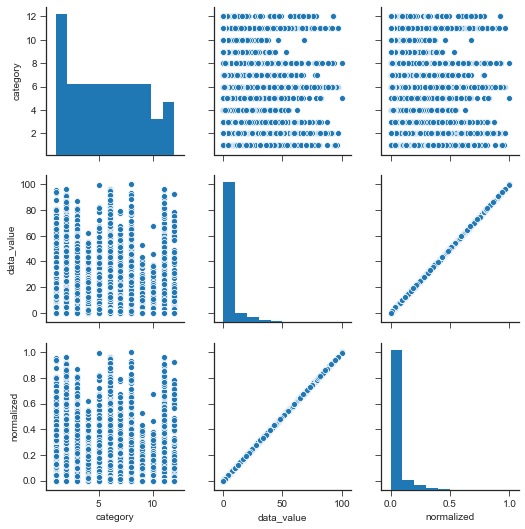

In [25]:
g = sns.pairplot(train_exp)

In [26]:
skills = pd.DataFrame(train_exp.groupby('element_name')['data_value'].sum()).reset_index()
skills.sort_values(by = 'data_value',ascending=False,inplace = True )

In [27]:
vals_skl = [x for x in train_exp.element_name]
vals_job = [x for x in train_exp.title]
custom_stopword = [x for x in skills.element_name[skills.data_value >= skills.data_value.mean()]]

In [28]:
len(str(vals_skl)),len(str(vals_job)),len(str(custom_stopword))

(2566746, 3873054, 113)

In [29]:
for x in custom_stopword:
    STOPWORDS.add(x)

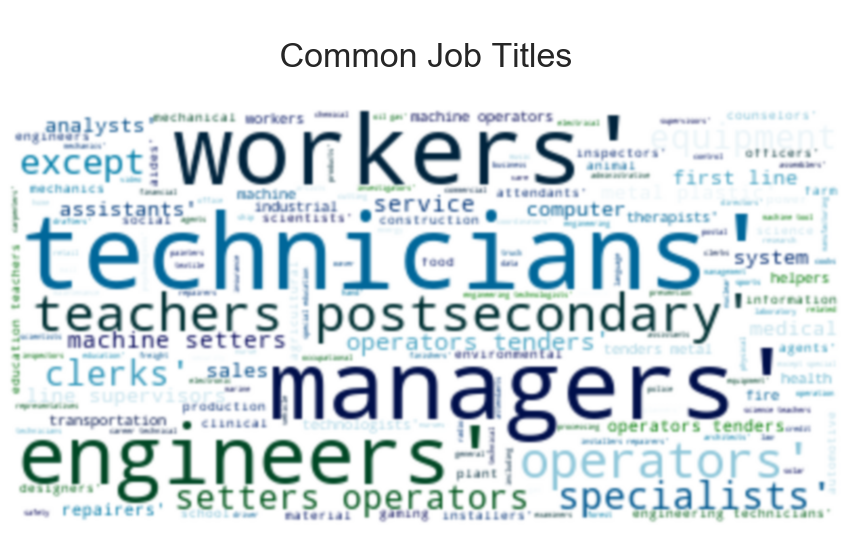

In [30]:
wordcloud = WordCloud(max_font_size=50, max_words=400000, 
                      background_color="#fff",stopwords=STOPWORDS, 
                      colormap=plt.cm.ocean).generate(str(set(vals_job)).lower(
))
plt.figure(figsize=(15,50))
plt.imshow(wordcloud, interpolation="bicubic")
plt.title('\n Common Job Titles \n ' ,fontsize=34)
plt.axis("off")
plt.show()

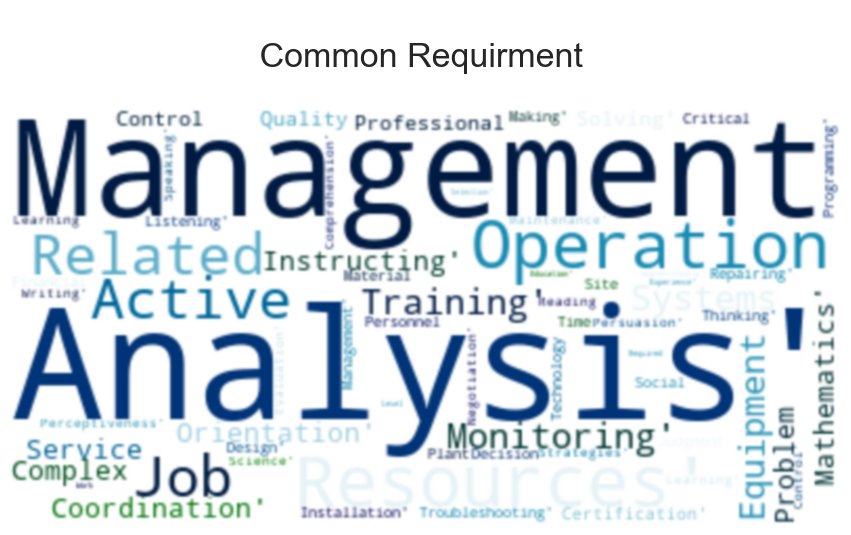

In [31]:
wordcloud = WordCloud(max_font_size=100, max_words=7007000, 
                      background_color="#fff",stopwords=STOPWORDS, 
                      colormap=plt.cm.ocean).generate(str(set(vals_skl)))
plt.figure(figsize=(15,50))
plt.imshow(wordcloud, interpolation="bicubic")
plt.title('\n Common Requirment  \n ' ,fontsize=34)
plt.axis("off")
plt.show()

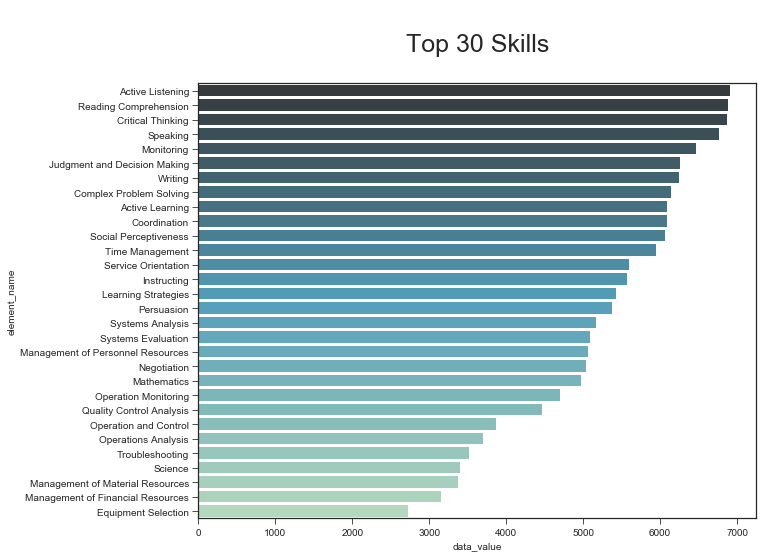

In [32]:
plt.figure(figsize=(10,8))
sns.barplot(data = skills[skills.data_value <= skills.data_value.mean()][:30],
            x= 'data_value',y='element_name',palette="GnBu_d")
plt.title('\n Top 30 Skills \n ' ,fontsize=25);

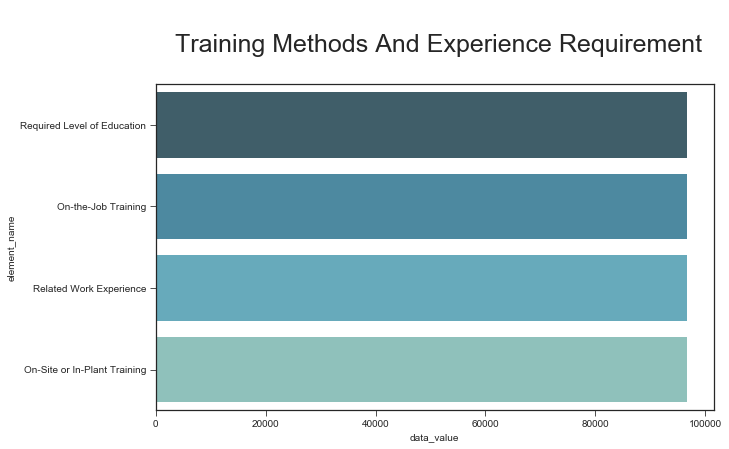

In [33]:

plt.figure(figsize=(10,6))
sns.barplot(data = skills[skills.data_value >= skills.data_value.mean()],
            x= 'data_value',y='element_name',palette="GnBu_d")
plt.title('\n Training Methods And Experience Requirement\n ' ,fontsize=25);

In [34]:
merge_sub = mergedStuff[['category' ,'category_description' ,'data_value']]
grouped = pd.DataFrame(merge_sub.groupby(['category','category_description'])['category'].sum()).rename(columns={'category':'Value'}).reset_index()

fig = px.bar( grouped , x='category', y='Value',
             hover_data=['category', 'category_description', 'Value'],
             height=600,color='category',color_continuous_scale=px.colors.sequential.Teal,
             title=' Formal Education And Experience Requirement',template='plotly_white')

q.plot(fig, filename='Formal Education And Experience Requirement', sharing='public')

'https://plotly.com/~sara-oct/11/'

In [35]:
edu = mergedStuff['category'].values
labels = (np.array(mergedStuff.category_description))
values = (np.array((edu / edu.sum())*100))

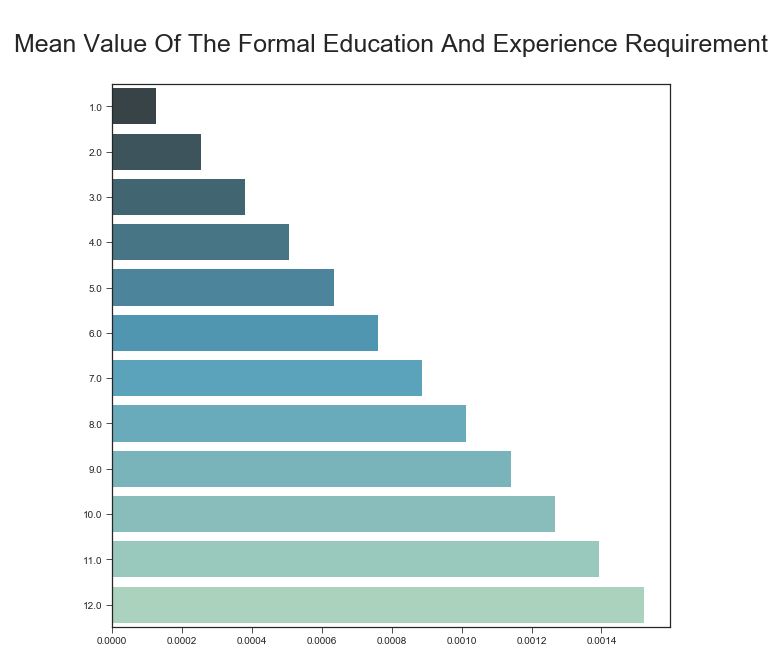

In [36]:
plt.figure(figsize=(10,10))
sns.barplot(x= values,y=edu,palette="GnBu_d",orient= 'h')
plt.title('\n Mean Value Of The Formal Education And Experience Requirement \n ' ,fontsize=25);

In [441]:
rating_job = pd.DataFrame(train_exp.groupby(['job_id','title','scale_id','element_name'])['data_value'].sum()).reset_index(['element_name','scale_id','title','job_id'])
rating_job.sort_values(by = 'data_value', inplace = True)
mask_1= rating_job[(rating_job.scale_id == 'IM') |(rating_job.scale_id == 'LV') ]
mask_2= rating_job[(rating_job.scale_id != 'IM') |(rating_job.scale_id != 'LV') ]

In [442]:


fig = px.scatter( mask_1 , x='data_value', y='scale_id',
                 hover_data=['title','element_name'], size='data_value',
                 width=800,height=700,animation_frame='title',range_x=[.5,6],
                 facet_col="scale_id",
                 color='scale_id',color_discrete_sequence=px.colors.diverging.Portland,
                 title=' Job Titles And Training Scale',template='plotly_white')

py.iplot(fig, filename='Job Titles And Training Scale.html')

In [39]:
avg_rate  = rating_job.loc[rating_job['data_value'] > rating_job['data_value'].min()]

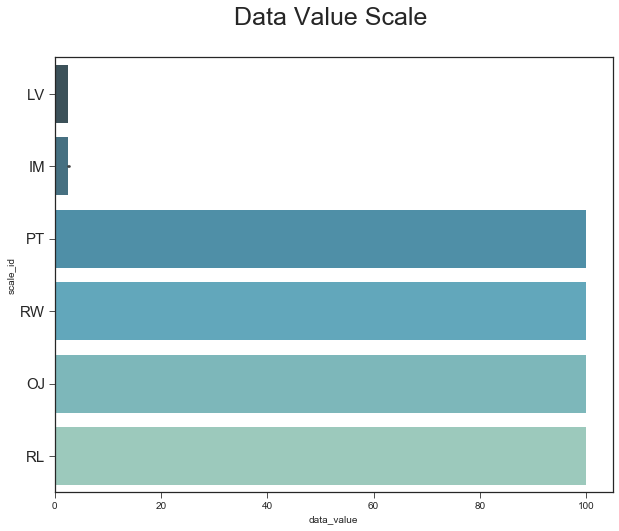

In [40]:
plt.figure(figsize=(10,8))
sns.barplot(y = avg_rate.scale_id,x = 'data_value',data=avg_rate ,palette="GnBu_d" )
plt.yticks(fontsize = 15)
plt.title('Data Value Scale \n' ,fontsize = 25);

In [41]:
code_job = pd.DataFrame(train_exp.groupby(['job_id','title'])['element_id'].count()).reset_index('title')

code_job.shape

(968, 2)

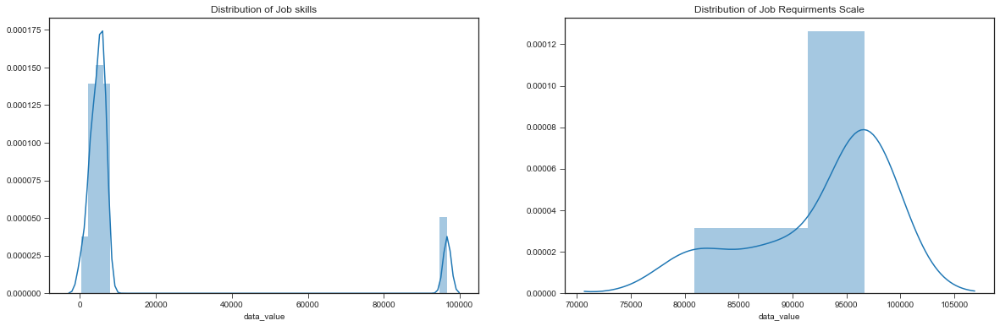

In [42]:
# Check
fig, ax = plt.subplots(1, 2, figsize=(20, 6))
sns.distplot(train_exp.groupby('scale_id')['data_value'].sum(), ax =ax[1])
ax[1].set_title('Distribution of Job Requirments Scale') 
sns.distplot(train_exp.groupby('element_id')['data_value'].sum(), ax =ax[0] )
ax[0].set_title('Distribution of Job skills') 
plt.show()


# Start Modelling

# Models – Nearest-neighbor-based method 
- Nearest-neighbor methods are based on the similarity between pairs of items or users. 
- Cosine similarity and correlation similarity  both matrices were applied and tested. 


In [306]:
import sklearn.metrics as metrics
import numpy as np
from sklearn.neighbors import NearestNeighbors
from scipy.spatial.distance import correlation, cosine
import ipywidgets as widgets
from IPython.display import display, clear_output
from sklearn.metrics import pairwise_distances
from sklearn.metrics import mean_squared_error
from math import sqrt
import sys, os
from contextlib import contextmanager

global k,metric
k=10
metric='cosine'

In [329]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
M = train_exp.pivot_table(index='job_id', columns='element_id', values='normalized').dropna().reset_index()

M['job_id'] = le.fit_transform(M.job_id)

In [330]:
M

element_id,job_id,2.A.1.a,2.A.1.b,2.A.1.c,2.A.1.d,2.A.1.e,2.A.1.f,2.A.2.a,2.A.2.b,2.A.2.c,...,2.B.5.a,2.B.5.b,2.B.5.c,2.B.5.d,2.D.1,2.D.4.a,3.A.1,3.A.2,3.A.3,3.A.4.a
0,0,0.03875,0.04120,0.03815,0.04060,0.03125,0.01120,0.04060,0.03685,0.03125,...,0.03690,0.03185,0.02620,0.03500,0.083333,0.0198,0.090909,0.111111,0.111111,0.0211
1,1,0.04125,0.04060,0.04190,0.04250,0.02620,0.01120,0.03810,0.03375,0.03060,...,0.03625,0.03125,0.02620,0.03310,0.083342,0.0174,0.090918,0.111122,0.111111,0.0161
2,2,0.04435,0.04440,0.04250,0.04380,0.03185,0.01565,0.04315,0.04000,0.04435,...,0.04000,0.03690,0.03185,0.04190,0.083342,0.0411,0.090918,0.111111,0.111111,0.0296
3,3,0.04370,0.04125,0.04125,0.04125,0.03000,0.01000,0.04185,0.03940,0.03875,...,0.04000,0.03120,0.03190,0.03875,0.083333,0.0236,0.090909,0.111111,0.111100,0.0153
4,4,0.03935,0.04065,0.03875,0.03935,0.02870,0.02125,0.04000,0.03880,0.03685,...,0.03940,0.02870,0.02380,0.04130,0.083325,0.0273,0.090909,0.111111,0.111111,0.0202
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,104,0.02815,0.03000,0.02620,0.02940,0.01940,0.00935,0.02940,0.02685,0.02185,...,0.02940,0.01250,0.01500,0.02120,0.083333,0.0234,0.090927,0.111111,0.111122,0.0241
105,105,0.03185,0.03250,0.02880,0.03125,0.03000,0.02370,0.03250,0.03000,0.02685,...,0.03060,0.01250,0.01500,0.02380,0.083342,0.0366,0.090909,0.111100,0.111100,0.0226
106,106,0.02500,0.02630,0.02315,0.02565,0.01560,0.01060,0.02500,0.02120,0.02185,...,0.02690,0.00750,0.00880,0.02125,0.083342,0.0282,0.090909,0.111111,0.111122,0.0271
107,107,0.02565,0.02935,0.02310,0.02625,0.01875,0.00500,0.02935,0.02310,0.01935,...,0.02935,0.01375,0.01250,0.01810,0.083325,0.0284,0.090909,0.111122,0.111111,0.0168


In [331]:
cosine_sim = 1-pairwise_distances(M, metric="cosine")

pearson_sim = 1-pairwise_distances(M, metric="correlation")

In [332]:
#Cosine similarity matrix
pd.DataFrame(cosine_sim)

,0,1,2,3,4,5,6,7,8,9,...,99,100,101,102,103,104,105,106,107,108
0,1.000000,0.258672,0.140953,0.090722,0.068761,0.052515,0.042036,0.036084,0.031595,0.030881,...,0.002456,0.002391,0.002482,0.002514,0.002295,0.002284,0.002364,0.002131,0.002121,0.002130
1,0.258672,1.000000,0.992535,0.985380,0.981357,0.978120,0.975867,0.974589,0.973548,0.973360,...,0.966497,0.966480,0.966503,0.966511,0.966454,0.966452,0.966473,0.966414,0.966412,0.966414
2,0.140953,0.992535,1.000000,0.998591,0.997248,0.995917,0.994896,0.994282,0.993814,0.993754,...,0.990199,0.990188,0.990203,0.990209,0.990175,0.990173,0.990188,0.990152,0.990150,0.990151
3,0.090722,0.985380,0.998591,1.000000,0.999715,0.999227,0.998750,0.998467,0.998198,0.998143,...,0.996056,0.996051,0.996059,0.996062,0.996042,0.996041,0.996049,0.996028,0.996028,0.996028
4,0.068761,0.981357,0.997248,0.999715,1.000000,0.999840,0.999599,0.999430,0.999281,0.999262,...,0.997777,0.997772,0.997779,0.997781,0.997765,0.997765,0.997771,0.997755,0.997754,0.997754
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,0.002284,0.966452,0.990173,0.996041,0.997765,0.998718,0.999193,0.999418,0.999559,0.999573,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
105,0.002364,0.966473,0.990188,0.996049,0.997771,0.998722,0.999196,0.999421,0.999562,0.999576,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
106,0.002131,0.966414,0.990152,0.996028,0.997755,0.998710,0.999187,0.999413,0.999555,0.999568,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
107,0.002121,0.966412,0.990150,0.996028,0.997754,0.998710,0.999186,0.999413,0.999555,0.999567,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [334]:
pd.DataFrame(pearson_sim)

,0,1,2,3,4,5,6,7,8,9,...,99,100,101,102,103,104,105,106,107,108
0,1.000000,-0.036094,-0.123944,-0.148188,-0.164044,-0.171039,-0.176514,-0.179291,-0.183261,-0.187061,...,-0.201160,-0.201089,-0.201238,-0.201270,-0.201056,-0.201111,-0.201193,-0.201062,-0.201041,-0.201083
1,-0.036094,1.000000,0.995915,0.993591,0.991630,0.990693,0.989900,0.989538,0.988922,0.988334,...,0.986074,0.986086,0.986061,0.986055,0.986090,0.986082,0.986068,0.986090,0.986094,0.986088
2,-0.123944,0.995915,1.000000,0.999604,0.999074,0.998772,0.998468,0.998320,0.998083,0.997827,...,0.996817,0.996822,0.996810,0.996808,0.996826,0.996821,0.996816,0.996826,0.996828,0.996824
3,-0.148188,0.993591,0.999604,1.000000,0.999831,0.999691,0.999527,0.999472,0.999319,0.999164,...,0.998512,0.998516,0.998508,0.998506,0.998517,0.998515,0.998511,0.998518,0.998519,0.998517
4,-0.164044,0.991630,0.999074,0.999831,1.000000,0.999953,0.999887,0.999861,0.999791,0.999707,...,0.999271,0.999273,0.999268,0.999266,0.999275,0.999273,0.999270,0.999275,0.999276,0.999274
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,-0.201111,0.986082,0.996821,0.998515,0.999273,0.999511,0.999669,0.999744,0.999824,0.999886,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
105,-0.201193,0.986068,0.996816,0.998511,0.999270,0.999509,0.999668,0.999743,0.999822,0.999885,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
106,-0.201062,0.986090,0.996826,0.998518,0.999275,0.999513,0.999671,0.999746,0.999825,0.999887,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
107,-0.201041,0.986094,0.996828,0.998519,0.999276,0.999514,0.999671,0.999746,0.999825,0.999887,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [336]:
#This function finds k similar users given the id_ and ratings matrix M
#Note that the similarities are same as obtained via using pairwise_distances
def findksimilarjob(id_, ratings, metric = metric, k=k):
    similarities=[]
    indices=[]
    model_knn = NearestNeighbors(metric = metric, algorithm = 'brute') 
    model_knn.fit(ratings)

    distances, indices = model_knn.kneighbors(ratings.iloc[id_-1, :].values.reshape(1, -1), n_neighbors = k+1)
    similarities = 1-distances.flatten()
    print ('{0} most similar jobs for job {1}:\n'.format(k,id_))
    for i in range(0, len(indices.flatten())):
        if indices.flatten()[i]+1 == id_:
            continue;

        else:
            print ('{0}: job_id {1}, with similarity of {2}'.format(i, indices.flatten()[i]+1, similarities.flatten()[i]))
            
    return similarities,indices

In [347]:
similarities = findksimilarjob(2,M, metric='cosine')

10 most similar jobs for job 2:

1: job_id 3, with similarity of 0.992535172175514
2: job_id 4, with similarity of 0.9853796261657184
3: job_id 5, with similarity of 0.981357496726175
4: job_id 6, with similarity of 0.9781199598073811
5: job_id 7, with similarity of 0.9758669838335225
6: job_id 8, with similarity of 0.974588883236037
7: job_id 9, with similarity of 0.9735479627343734
8: job_id 10, with similarity of 0.973360303678394
9: job_id 11, with similarity of 0.972101008425505
10: job_id 12, with similarity of 0.9716138450580285


In [351]:
similarities = findksimilarjob(1,M, metric='correlation')

10 most similar jobs for job 1:

1: job_id 2, with similarity of -0.03609448941099025
2: job_id 3, with similarity of -0.12394447433135403
3: job_id 4, with similarity of -0.1481877579367099
4: job_id 5, with similarity of -0.16404432534643565
5: job_id 6, with similarity of -0.17103871961894046
6: job_id 7, with similarity of -0.17651419407749658
7: job_id 8, with similarity of -0.1792911782357245
8: job_id 9, with similarity of -0.18326146353475203
9: job_id 10, with similarity of -0.18706075876521022
10: job_id 11, with similarity of -0.18762367079332565


# Model  :  Word2vec applied to Recommendation
     similer_by_vector()

In [401]:
#  job-code 
job_code = train_exp['element_id'].unique().tolist()

In [405]:
# extract 70% of job-code 
train = [job_code[i] for i in range(round(0.7*len(job_code)))]

# split data into train and validation set
train_df = train_exp[train_exp['element_id'].isin(train)]
validation_df = train_exp[~train_exp['element_id'].isin(train)]

In [406]:
len(train_df)


56144

In [407]:
len(validation_df)

51482

In [408]:
# list to capture history of the employees
train_li = []

for i in tqdm(train):
    temp = train_df[train_df["element_id"] == i]["job_id"].unique().tolist()
    train_li.append(temp)

100%|██████████| 29/29 [00:00<00:00, 180.53it/s]


In [411]:
# Test_df

test_li = []

for i in tqdm(validation_df["element_id"].unique()):
    temp = validation_df[validation_df["element_id"] == i]["job_id"].unique().tolist()
    test_li.append(temp)

100%|██████████| 12/12 [00:00<00:00, 217.47it/s]


- using different values for some hyperparameters, namely negative sampling distribution, number of epochs, subsampling parameter and window-size, leads to significantly better performances.
----
- Word2Vec training is an unsupervised task.

In [419]:
# train word2vec model
model = Word2Vec(window = 10, sg = 1, hs = 0,
                 negative = 10, # for negative sampling
                 alpha=0.03, min_alpha=0.0007,
                 seed = 14)

model.build_vocab(train_li, progress_per=200)

model.train(train_li, total_examples = model.corpus_count, 
            epochs=10, report_delay=1)

(280720, 280720)

In [420]:
# save word2vec model
model.save("word2vec_2.model")

In [421]:
# # L2-normalized vectors.

model.init_sims(replace=True)

print(model)

# # extract all vectors
X = model[model.wv.vocab]

print(X.shape)

Word2Vec(vocab=968, size=100, alpha=0.03)
(968, 100)


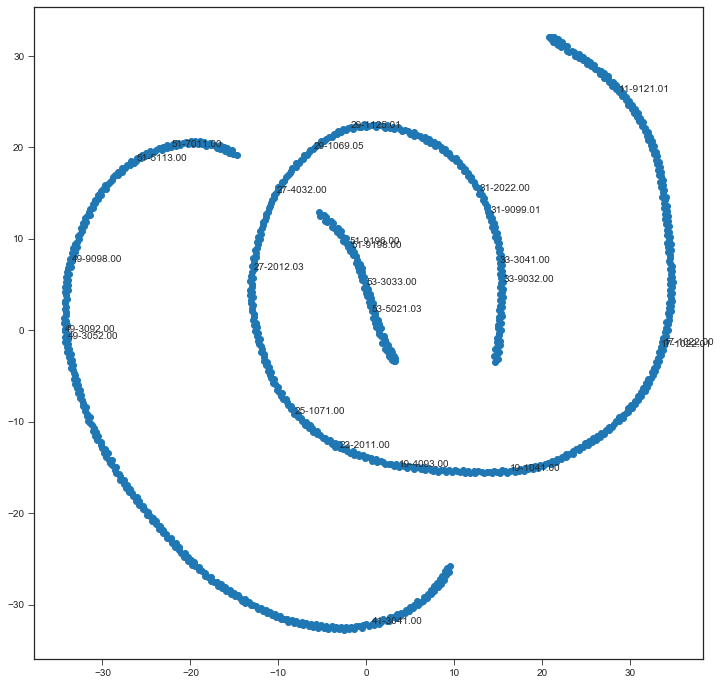

In [422]:
def reduce_dimensions(model):
    num_dimensions = 2  # final num dimensions (2D, 3D, etc)

    vectors = [] # positions in vector space
    labels = [] # keep track of words to label our data again later
    for word in model.wv.vocab:
        vectors.append(model.wv[word])
        labels.append(word)

    # convert both lists into numpy vectors for reduction
    vectors = np.asarray(vectors)
    labels = np.asarray(labels)

    # reduce using t-SNE
    vectors = np.asarray(vectors)
    tsne = TSNE(n_components=num_dimensions, random_state=0)
    vectors = tsne.fit_transform(vectors)

    x_vals = [v[0] for v in vectors]
    y_vals = [v[1] for v in vectors]
    return x_vals, y_vals, labels


x_vals, y_vals, labels = reduce_dimensions(model)

def plot_with_plotly(x_vals, y_vals, labels, plot_in_notebook=True):
    from plotly.offline import init_notebook_mode, iplot, plot
    import plotly.graph_objs as go

    trace = go.Scatter(x=x_vals, y=y_vals, mode='text', text=labels)
    data = [trace]
    

    if plot_in_notebook:
        init_notebook_mode(connected=True)
        iplot(data, filename='word-embedding-plot')
     
    else:
        plot(data, filename='word-embedding-plot.html')


def plot_with_matplotlib(x_vals, y_vals, labels):
    import matplotlib.pyplot as plt
    import random

    random.seed(0)

    plt.figure(figsize=(12, 12))
    plt.scatter(x_vals, y_vals)

    #
    # Label randomly subsampled 25 data points
    #
    indices = list(range(len(labels)))
    selected_indices = random.sample(indices, 25)
    for i in selected_indices:
        plt.annotate(labels[i], (x_vals[i], y_vals[i]))

try:
    get_ipython()
except Exception:
    plot_function = plot_with_matplotlib
else:
    plot_function = plot_with_plotly

plot_with_matplotlib(x_vals, y_vals, labels)

### Recommendations from similar jobs 

In [423]:

def aggregate_vectors(test):
    test_vec = []
    for i in test:
        
        try:
            test_vec.append(model[i])
        except KeyError:
            continue
        
    return np.mean(test_vec, axis=0)

In [424]:
aggregate_vectors(test_li[0]).shape

(100,)

In [425]:
test_li[0][:1]

['11-1011.00']

In [426]:
# test_li 

In [427]:
df_select = train_exp[['title','job_id','scale_id','scale_name','element_name','data_value','category']]


In [428]:
def recommend (v , n=0):
    ms_2 = model.wv.similar_by_vector(v, topn= n+1)[:]
    df= pd.DataFrame()
    li =[]
    sim =[]
   
    for j in ms_2:
        entry = {}
        li.append(j[0])
        sim.append(j[1])
        entry['job_id'] = li
        entry['similarty'] = sim

        df = df.append(pd.DataFrame(entry), sort=True)
        df_me = pd.merge(df_select, df, on=['job_id'], how='inner' )
        df_me['evaluate'] = df_me['similarty'] *df_me['data_value']
        df_me.sort_values(by = 'similarty' , ascending = False , inplace =True)


        dataframe = pd.merge(df_me,categories[['scale_id','category_description','category']] , on = ['scale_id','category'], how = 'outer').sort_values(by = 'similarty', ascending = False)
        dataframe.category_description.fillna('Skills',inplace= True)
        
        dataframe.set_index('scale_id' , inplace =True)
    print(' Job Title : {} \n   Similarity : {} \n  Resultes From : {}, Similar Jobs \n'.format( str(df_me['title'].unique().tolist()[0]) ,
          df_me['similarty'].unique().tolist()[0] , n ))
    print(df_me['title'].unique().tolist())
    
    
    Data = dataframe[['element_name' ,'category_description','evaluate']].sort_values(by = 'evaluate', ascending= False).drop_duplicates()
    
    df_oj = Data[(Data.index == 'OJ') |(Data.index == 'PT') ].drop_duplicates('category_description')[:3]
    
    df_lv = Data[Data.index == 'LV'].drop_duplicates('element_name')[:10]
    
    df_im = Data[Data.index == 'IM'].drop_duplicates('element_name')[:10]
    
    df_rw = Data[Data.index == 'RW'].drop_duplicates('category_description')[:2]
    
    df_rl = Data[Data.index == 'RL'].drop_duplicates('category_description')[:2]


    print(tabulate(df_oj,  tablefmt='fancy_grid'))
    print(tabulate(df_lv,   tablefmt="fancy_grid"))
    print(tabulate(df_im,   tablefmt="fancy_grid"))
    print(tabulate(df_rw,   tablefmt="fancy_grid"))
    print(tabulate(df_rl,   tablefmt="fancy_grid"))
    
    return dataframe.drop_duplicates()
    


In [432]:
# Train Data
tr_acuracy = recommend(model['25-1066.00'],10)

 Job Title : Psychology Teachers, Postsecondary 
   Similarity : 1.0 
  Resultes From : 10, Similar Jobs 

['Psychology Teachers, Postsecondary', 'Sociology Teachers, Postsecondary', 'Political Science Teachers, Postsecondary', 'Health Specialties Teachers, Postsecondary', 'Geography Teachers, Postsecondary', 'Nursing Instructors and Teachers, Postsecondary', 'Economics Teachers, Postsecondary', 'Education Teachers, Postsecondary', 'Area, Ethnic, and Cultural Studies Teachers, Postsecondary', 'Library Science Teachers, Postsecondary', 'Anthropology and Archeology Teachers, Postsecondary']
╒════╤══════════════════════════════╤══════════════════════════════════════════════════════════════════╤═════════╕
│ PT │ On-Site or In-Plant Training │ None                                                             │ 76.2624 │
├────┼──────────────────────────────┼──────────────────────────────────────────────────────────────────┼─────────┤
│ OJ │ On-the-Job Training          │ None or short demonst

In [433]:
#  Test/ Validation Data 
ab_test = recommend(aggregate_vectors(test_li[0][100:103]),10)

 Job Title : Tax Examiners and Collectors, and Revenue Agents 
   Similarity : 0.9997180104255676 
  Resultes From : 10, Similar Jobs 

['Tax Examiners and Collectors, and Revenue Agents', 'Loan Officers', 'Tax Preparers', 'Loan Counselors', 'Financial Quantitative Analysts', 'Risk Management Specialists', 'Credit Counselors', 'Fraud Examiners, Investigators and Analysts', 'Financial Examiners', 'Computer and Information Research Scientists', 'Insurance Underwriters']
╒════╤══════════════════════════════╤═════════════════════════════════════════════╤═════════╕
│ OJ │ On-the-Job Training          │ Over 1 year, up to and including 2 years    │ 42.4976 │
├────┼──────────────────────────────┼─────────────────────────────────────────────┼─────────┤
│ PT │ On-Site or In-Plant Training │ Over 3 months, up to and including 6 months │ 42.0055 │
├────┼──────────────────────────────┼─────────────────────────────────────────────┼─────────┤
│ PT │ On-Site or In-Plant Training │ None               

In [279]:

def plot(freq=1., color='blue', lw=2, grid=True):
    
    x_2 = ab_test['similarty']
    y_2 = ab_test.job_id
    
    x_3 = tr_acuracy['similarty']
    y_3 = tr_acuracy.job_id
    
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 6))

    sns.barplot(x= x_2,y = y_2,lw=lw, color=color , ax =ax[1])
    ax[1].set_title('Similarity Between Validation Data') 
    ax[1].grid(grid)
    sns.barplot(x= x_3,y = y_3,lw=lw, color=color , ax =ax[0])
    ax[0].set_title('Similarity Between Trained Data') 
    ax[0].grid(grid)
    fig.autofmt_xdate(rotation=45)

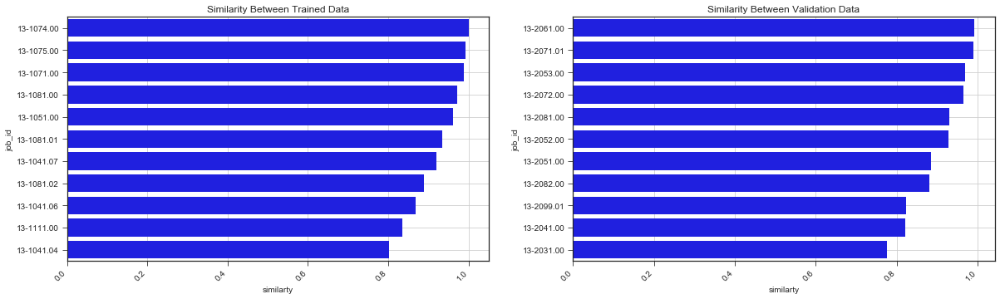

In [280]:
plot()

## Conclusion :

-  Training is important for creating and maintaining the right skill-proﬁle for the organization’s workforce.

- There is a variety in the available trainings within an organization: technical, project man-agement, quality, leadership, domain-speciﬁc, soft-skills, etc.

- presente word2vec algorithms for training recommendation in an industrial setting, to assist the employee in choosing the best trainings method and the best skills

- The input to the algorithms is just the dataset of sequences of past trainings done by the employees.


## Future Work :
- Enhancing the recommendation algorithms to make use of a detailed textual description of the contents of trainings. For example, using such descriptions, for a better represent to the concepts covered in the training leading to a better similarity measure for trainings.

- Incorporating feedback from people who have already completed a training to improve the recommen-dation algorithm, along with other information about the training such as its duration, or diﬃculty level.

- We are exploring planning techniques to recommend a sequence of trainings to an employee in order to meet her long-term career aspirations, for example, aiding a data analyst to move to the role of data scientist


## Data Source Credit 


 <p style="text-align: center"><a href="https://services.onetcenter.org/"><img src="https://www.onetcenter.org/image/link/onet-in-it.svg" style="width: 130px; height: 60px; border: none" alt="O*NET in-it"></a></p>
<p style="text-align: center" > <a href="https://services.onetcenter.org/">O*NET Web Services</a> </p>